In [1]:
!pip install pydicom matplotlib numpy pillow

from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Patient Name: VU THI NGUYET^80T
Modality: CT
Study Date: 20251106
Image Size: 512 x 512


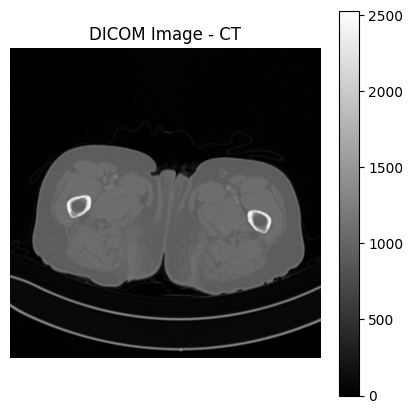

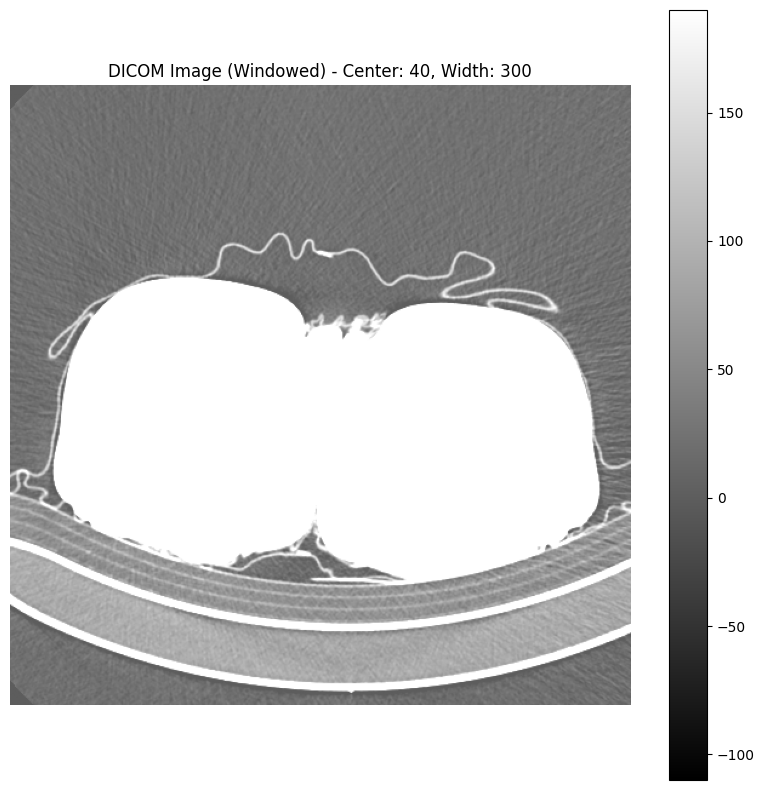

Patient Name: VU THI NGUYET^80T
Modality: CT
Study Date: 20251106
Image Size: 512 x 512


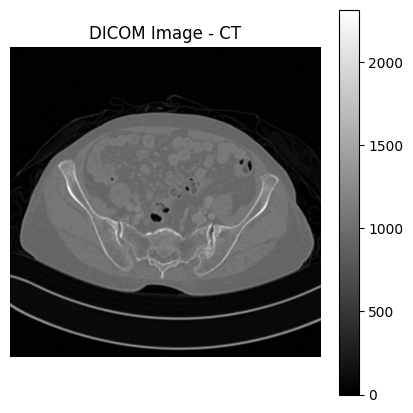

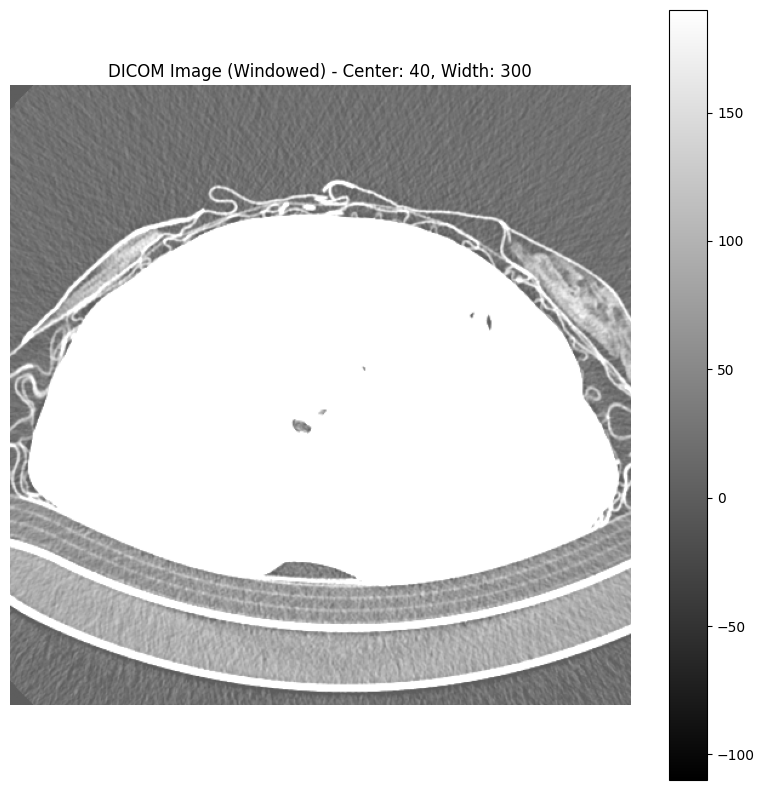

In [10]:
import pydicom
import matplotlib.pyplot as plt
import numpy as np

def display_dicom_image(dicom_filepath):
  # Read the DICOM file
  dicom_file = pydicom.dcmread(dicom_filepath)

  # Display basic metadata
  print("Patient Name:", dicom_file.PatientName)
  print("Modality:", dicom_file.Modality)
  print("Study Date:", dicom_file.StudyDate)
  print("Image Size:", dicom_file.Rows, "x", dicom_file.Columns)

  # Get the pixel array
  pixel_array = dicom_file.pixel_array

  # Display the image
  plt.figure(figsize=(5, 5))
  plt.imshow(pixel_array, cmap='gray')
  plt.colorbar()
  plt.title(f"DICOM Image - {dicom_file.Modality}")
  plt.axis('off')
  plt.show()

  # Optional: Display with proper windowing (for CT scans)
  # CT images often need window/level adjustments for proper visualization
  if hasattr(dicom_file, 'WindowCenter') and hasattr(dicom_file, 'WindowWidth'):
      window_center = dicom_file.WindowCenter
      window_width = dicom_file.WindowWidth

      # Handle multiple window values (take first if array)
      if isinstance(window_center, pydicom.multival.MultiValue):
          window_center = window_center[0]
      if isinstance(window_width, pydicom.multival.MultiValue):
          window_width = window_width[0]

      # Apply windowing
      img_min = window_center - window_width / 2
      img_max = window_center + window_width / 2

      windowed_image = np.clip(pixel_array, img_min, img_max)

      plt.figure(figsize=(10, 10))
      plt.imshow(windowed_image, cmap='gray', vmin=img_min, vmax=img_max)
      plt.colorbar()
      plt.title(f"DICOM Image (Windowed) - Center: {window_center}, Width: {window_width}")
      plt.axis('off')
      plt.show()

display_dicom_image("/content/drive/MyDrive/ColabNotebooks/dicom/example1.dcm")
display_dicom_image("/content/drive/MyDrive/ColabNotebooks/dicom/example2.dcm")

Found 390 DICOM slices
3D Volume shape: (390, 512, 512)


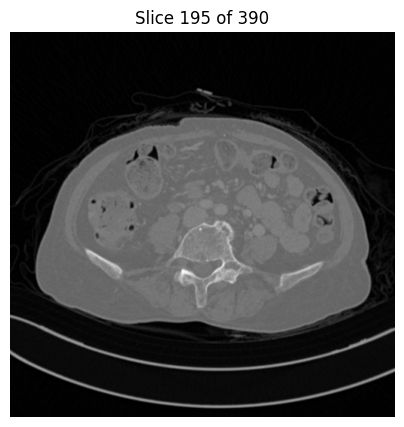

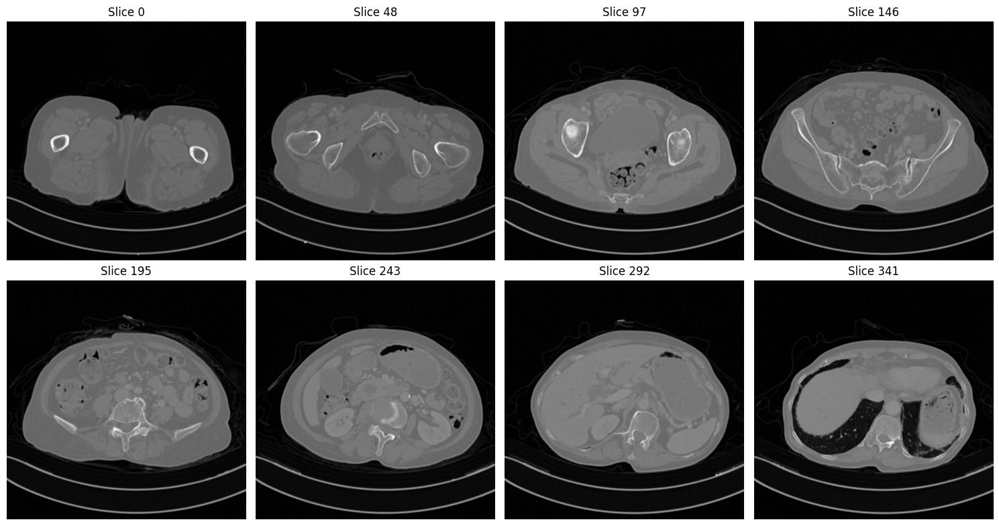

In [11]:
import pydicom
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import zipfile

# Extract zip file
with zipfile.ZipFile('/content/drive/MyDrive/ColabNotebooks/dicom/dicom_example.zip', 'r') as zip_ref:
    zip_ref.extractall('dicom_temp')

# Read all DICOM files
dicom_dir = Path('dicom_temp')
dicom_files = list(dicom_dir.glob('**/*.dcm'))

print(f"Found {len(dicom_files)} DICOM slices")

# Load all slices
slices = []
for file in dicom_files:
    ds = pydicom.dcmread(file)
    slices.append(ds)

# Sort by slice location (important!)
slices.sort(key=lambda x: float(x.ImagePositionPatient[2]))

# Alternative: sort by InstanceNumber
# slices.sort(key=lambda x: int(x.InstanceNumber))

# Stack into 3D volume
volume = np.stack([s.pixel_array for s in slices])
print(f"3D Volume shape: {volume.shape}")  # (num_slices, height, width)

# Visualize middle slice
middle_slice = len(slices) // 2
plt.figure(figsize=(5, 5))
plt.imshow(slices[middle_slice].pixel_array, cmap='gray')
plt.title(f"Slice {middle_slice} of {len(slices)}")
plt.axis('off')
plt.show()

# Visualize multiple slices
fig, axes = plt.subplots(2, 4, figsize=(15, 8))
for i, ax in enumerate(axes.flat):
    slice_idx = i * len(slices) // 8  # Sample evenly
    ax.imshow(slices[slice_idx].pixel_array, cmap='gray')
    ax.set_title(f"Slice {slice_idx}")
    ax.axis('off')
plt.tight_layout()
plt.show()

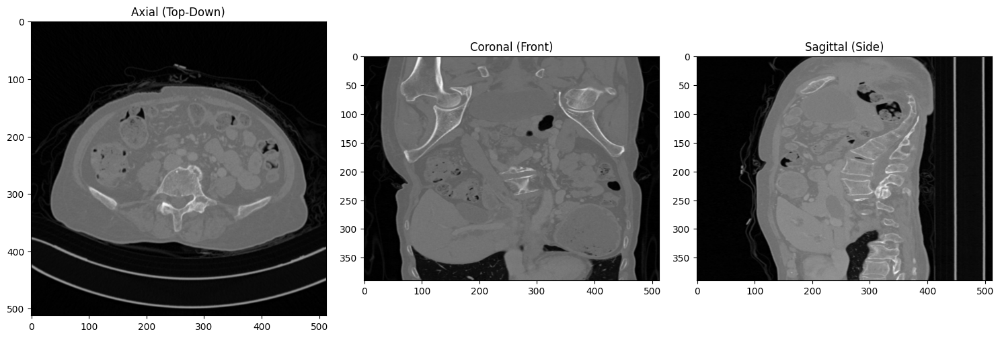

In [12]:
# Axial view (original slices)
plt.figure(figsize=(15, 5))

plt.subplot(131)
plt.imshow(volume[volume.shape[0]//2, :, :], cmap='gray')
plt.title('Axial (Top-Down)')

plt.subplot(132)
plt.imshow(volume[:, volume.shape[1]//2, :], cmap='gray')
plt.title('Coronal (Front)')

plt.subplot(133)
plt.imshow(volume[:, :, volume.shape[2]//2], cmap='gray')
plt.title('Sagittal (Side)')

plt.tight_layout()
plt.show()

In [13]:
# DON'T use %matplotlib widget or %matplotlib notebook in Colab
# Just use the default (inline)

import ipywidgets as widgets
import matplotlib.pyplot as plt

@widgets.interact(slice_idx=widgets.IntSlider(
    min=0, max=len(slices)-1, step=1,
    value=len(slices)//2, description='Slice:',
    continuous_update=False
))
def view_slice(slice_idx):
    plt.figure(figsize=(5, 5))
    plt.imshow(slices[slice_idx].pixel_array, cmap='gray')
    plt.title(f'Slice {slice_idx} of {len(slices)}')
    plt.axis('off')
    plt.show()

interactive(children=(IntSlider(value=195, continuous_update=False, description='Slice:', max=389), Output()),…

In [9]:
from matplotlib import animation
from IPython.display import HTML
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(5, 5))
ax.axis('off')

# Initial image
img_display = ax.imshow(slices[0].pixel_array, cmap='gray')
title = ax.set_title(f'Slice 0 of {len(slices)}')

def animate(i):
    img_display.set_array(slices[i].pixel_array)
    title.set_text(f'Slice {i} of {len(slices)}')
    return [img_display, title]

# Create animation
anim = animation.FuncAnimation(
    fig, animate, frames=len(slices),
    interval=100,  # milliseconds between frames (adjust for speed)
    blit=True, repeat=True
)

# Display in Colab
plt.close()  # Prevent duplicate display
HTML(anim.to_jshtml())